# TO BE RUN IN LOCAL
If you have a working environement, you don't need to run the following cells

In [ ]:
# ! git clone https://github.com/IVRL/LELSD.git

fatal: destination path 'LELSD' already exists and is not an empty directory.


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install clip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install --upgrade torch==1.9.1+cu111 torchvision==0.10.1+cu111 -f https://download.pytorch.org/whl/torch_stable.html
!pip install -e ./CLIP
!pip install einops ninja
!git clone https://github.com/NVlabs/stylegan3
!git clone https://github.com/openai/CLIP
!pip install boto3
import sys
sys.path.append('./CLIP')
sys.path.append('./stylegan3')

import io
import os, time, glob
import pickle
import shutil
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
import requests
import torchvision.transforms as transforms
import torchvision.transforms.functional as TF
import unicodedata
import re
from tqdm.notebook import tqdm
from torchvision.transforms import Compose, Resize, ToTensor, Normalize
from IPython.display import display
from einops import rearrange
import matplotlib.pyplot as plt
from google.colab import files

device = torch.device('cuda:0')
print('Using device:', device, file=sys.stderr)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/CLIP
     |████████████████████████████████| 53 kB 1.4 MB/s 
  Running setup.py develop for clip
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
fatal: destination path 'stylegan3' already exists and is not an empty directory.
fatal: destination path 'CLIP' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


/usr/local/lib/python3.7/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.9) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using device: cuda:0


# Manipulations

In [ ]:
#%cd LELSD/notebooks #If repository is cloned!

[Errno 2] No such file or directory: 'LELSD/notebooks'
/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [5]:
%cd ./drive/MyDrive/LELSD/notebooks

/content/drive/MyDrive/LELSD/notebooks


In [76]:
# !pip install boto3 botocore awscli --ignore-installed
# !pip install ninja
# !pip install torch==1.9.0
# !pip install torchvision==0.10.0

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import pickle
from copy import deepcopy
from tqdm import tqdm
import sys
import PIL
import cv2

sys.path.append("../")
import models
from lelsd import LELSD
from utils.stylegan2_utils import StyleGAN2SampleGenerator
from utils.stylegan3_utils import StyleGAN3SampleGenerator
from utils.segmentation_utils import FaceSegmentation

from spaceUtils import *

/usr/local/lib/python3.7/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.9) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)


In [8]:
def load_pretrained_model(model_name, dataset_name):
    if model_name != "biggan":
        G = models.get_model(model_name,
                             f"../pretrained/{model_name}/{model2available_dataset[model_name][dataset_name]}")
    else:
        G = models.get_model(model_name, model2available_dataset[model_name][dataset_name])
    return G

def get_batch_data(sample_generator, seed, model_name, dataset_name, bs=10):
    batch_data = sample_generator.generate_batch(seed, return_image=True, return_style=True, batch_size=bs)
    return batch_data

In [10]:
def edit_image_stylegan2(sample_gen,ys,rgb_ys,alpha,c,L):
        modif = deepcopy(ys)
        modif[L][0,c] = modif[L][0,c] + alpha
        return sample_gen.generate_image_from_ys(modif, rgb_ys, raw=False)[0]

def edit_image_stylegan3(sample_gen,ys,alpha,c,L):
        modif = deepcopy(ys)
        modif[L][0,c] = modif[L][0,c] + alpha
        return sample_gen.generate_image_from_ys(modif, raw=False)[0]
        
def edit_get_all_infos_stylegan2(sample_gen,ys,rgb_ys,alpha,c,L):
        modif = deepcopy(ys)
        modif[L][0,c] = modif[L][0,c] + alpha
        return sample_gen.generate_batch_from_ys((modif, rgb_ys),return_image = True, return_all_layers = True)

def edit_get_all_infos_stylegan3(sample_gen,ys,alpha,c,L):
        modif = deepcopy(ys)
        modif[L][0,c] = modif[L][0,c] + alpha
        return sample_gen.generate_batch_from_ys(modif, return_image = True, return_all_layers = True)

        
def plotManip(imageModif, labels, layer, channel):
        n,r = imageModif.shape[:2]
        fig, ax = plt.subplots(n,3, figsize=(15,10))
        modif = ['-', 'original','+']
        for i in range(n):
          for j in range(r):
            typeModif = modif[j]
            ax[i,j].imshow(imageModif[i,j])
            if typeModif == 'original':
                ax[i,j].set_title(f"{typeModif}")
                ax[i,j].spines['bottom'].set_color('red')
                ax[i,j].spines['bottom'].set_linewidth(5)
                ax[i,j].spines['top'].set_color('red') 
                ax[i,j].spines['top'].set_linewidth(5)
                ax[i,j].spines['right'].set_color('red')
                ax[i,j].spines['right'].set_linewidth(5)
                ax[i,j].spines['left'].set_color('red')
                ax[i,j].spines['left'].set_linewidth(5)
            else:
                ax[i,j].set_title(f"{typeModif} {layer}_{channel[i]}")
          ax[i,0].set_ylabel('{} manip'.format(labels[i]))
        plt.tight_layout()
        plt.show()

In [78]:
dataset_name   = 'FFHQ',
truncation_psi = 0.7
model2available_dataset = {
    "stylegan2":{
        "FFHQ":"ffhq.pkl",
        },
    "stylegan3": {
        "FFHQ-R": "stylegan3-r-ffhqu-1024x1024.pkl",
        "FFHQ-T": "stylegan3-t-ffhq-1024x1024.pkl",
        }
}

#StyleGAN2

In [152]:
model_name = 'stylegan2'
dataset_name = "FFHQ" 
G      = load_pretrained_model(model_name, dataset_name)
device     = torch.device('cuda') 
SG2 = StyleGAN2SampleGenerator(G=G, device=device, truncation_psi=truncation_psi) 
          
# 1/ image generated with random seed outside of range we used for ranking 
# 2/ we use the same image for all layer manipulations like they do in the paper 
data   = get_batch_data(SG2, 10400, model_name, dataset_name, bs=1) 
ysSG2     = data['ys'] 
rgb_ysSG2 = data['rgb_ys']

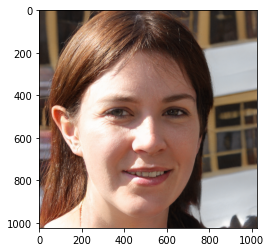

In [153]:
original = data['image'][0]
plt.imshow(original)

In [154]:
# Checking which are the top10 channels for 3 different semantics namely: hair, eyes and mouth:
# Note: we are using channels found from 18 semantics prior to merging in stylegan2 
def print_ranked_semantic_SG2(layer,semantics = ['hair', 'r_eye', 'mouth'], number = 10):
  """
  layer: int, which layer we want the rank
  semantics: list of strings, for which semantics do we want the rank
  number: int, top number of channels
  """
  rankS2 = np.load('../logs/channelRankS2/rankL{}.npy'.format(layer))
  print('Layer :{}'.format(layer))
  for semantic in semantics:
    rankedS2H = np.argsort(rankS2[0][:,part_to_mask_idx[semantic]])[::-1]
    print(f'{semantic}  :{rankedS2H[:number]}')


In [22]:
#Layer 2 (= Layer 3 in the StyleSpace paper!)
print_ranked_semantic_SG2(2, semantics = ['hair', 'r_ear'])

Layer :2
hair  :[246 379 169 239 236 187 136 337 421 259]
r_ear  :[235 412 218 431  95 141  11 419  16  32]


In [23]:
alpha = 10

editedHairM    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 169, 2)) #Taking the channel found in the top 10 that was also in their paper
editedHairP    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 169, 2))

editedEarsM    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 412, 2))
editedEarsP    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 412, 2))


to_plot = np.asarray([[editedHairM, original,editedHairP],
                    [editedEarsM, original, editedEarsP]])
labels = ['hair', 'ears']
channels = [169, 412]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


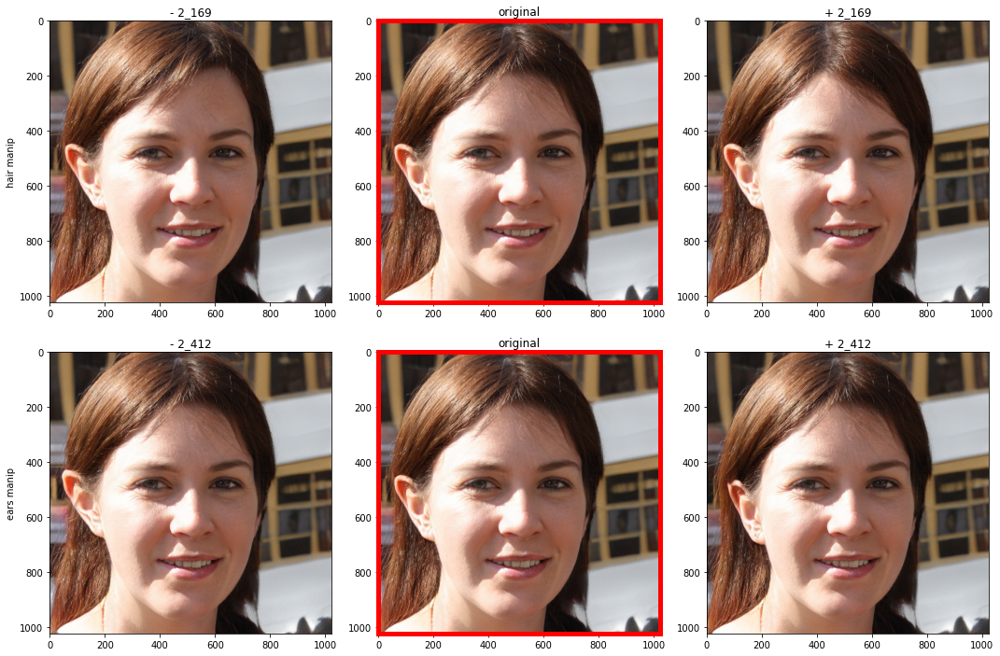

In [24]:
plotManip(to_plot, labels, 2, channels)

In [25]:
#Layer 4 (= Layer 6 in the StyleSpace paper!)
print_ranked_semantic_SG2(4, semantics = ['hair', 'mouth'])

Layer :4
hair  :[487  83 497 208 504 364 114 102  97 188]
mouth  :[379 113 202 378 214 501 259 491 381 324]


In [26]:
alpha = 10
editedHairM    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 487, 4))
editedHairP    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 487, 4))


editedMouthM   = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 379, 4))
editedMouthP   = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 379, 4))

labels = ['hair', 'mouth']
channels = [487, 379]
to_plot = np.asarray([[editedHairM, original,editedHairP],
                    [editedMouthM, original, editedMouthP]])



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if sys.path[0] == '':


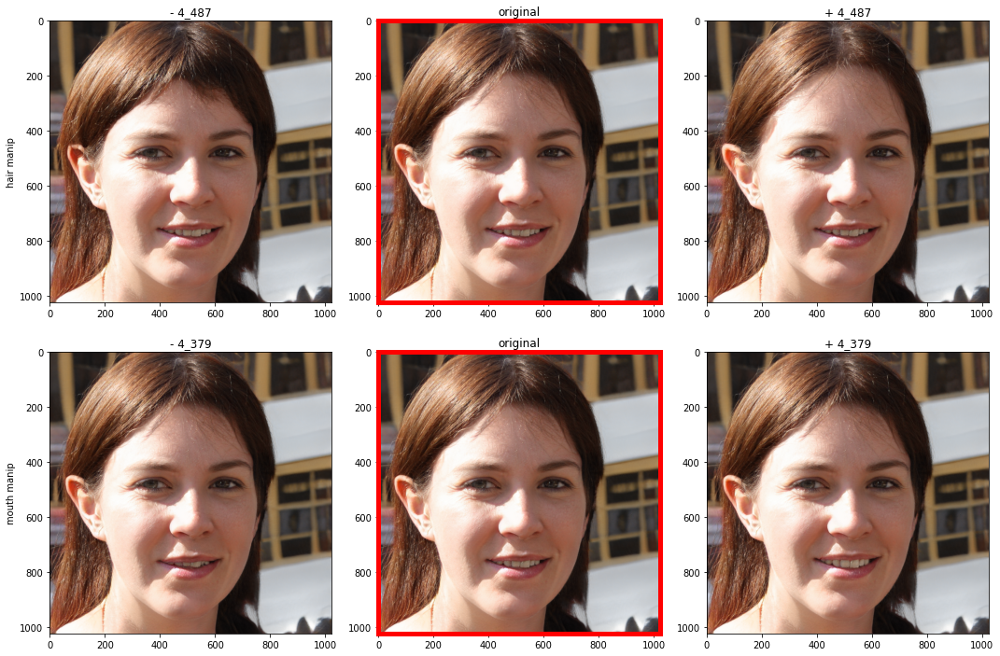

In [27]:
plotManip(to_plot, labels, 4, channels)

In [29]:
#Layer 6 (= Layer 9 in the StyleSpace paper!)
print_ranked_semantic_SG2(6, semantics = ['l_eye', 'l_brow'])

Layer :6
l_eye  :[409 143 386 393 117 167 286  63 483  43]
l_brow  :[135  30 340 233 278 440 487 407 509 510]


In [30]:
alpha = 10

editedEyeM    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 409, 6))
editedEyeP    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 409, 6))

editedEyebrowsM    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, -alpha, 340, 6))
editedEyebrowsP    = np.array(edit_image_stylegan2(SG2, ysSG2, rgb_ysSG2, alpha, 340, 6))

labels = ['eyes', 'eyebrows']
channels = [409, 340]
to_plot = np.asarray([[editedEyeM, original, editedEyeP],
                    [editedEyebrowsM,original, editedEyebrowsP]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if sys.path[0] == '':


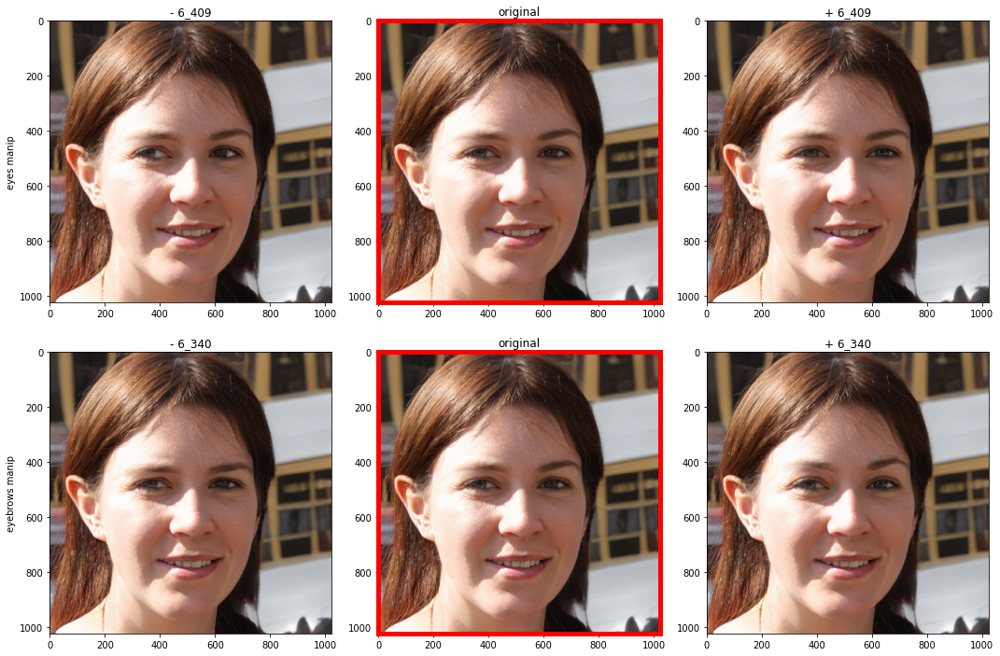

In [31]:
plotManip(to_plot, labels, 6, channels)

## GENERATE VIDEO FOR STYLEGAN2

In [155]:
def generate_video_SG2(duration, fps, layer_to_modify, channel_to_modify, features_maps,alpha = 10):
  """
  duration: int, duration of the video in seconds
  fps: int, frames per second
  layer_to_modify: int, which layer do we want to apply the transformation
  channel_to_modify: int, which channel we want to apply the transformation within the specified layer
  features_maps: list of tuples of the form (layer, channel). Creates a video of the specified features map. In order to have RGB, we take the specified channel
  + the 2 channels AFTER the one specified.

  output: Video of the modification + if specified, video of the feature maps
  """
  
  alphas = np.linspace(-alpha, alpha, duration*fps)

  videos = {"video_SG2":[]} #Creation of the dictionnary containing the video

  #Creation of the entries for the feature maps
  for (layer, channel) in features_maps:
    videos[f"l_{layer}_c{channel}"] = []
  
  for alpha in alphas:
    data = edit_get_all_infos_stylegan2(SG2,ysSG2,rgb_ysSG2,alpha,channel_to_modify,layer_to_modify)
    videos["video_SG2"].append(data['image'][0])
    for (layer, channel) in features_maps:
      videos[f"l_{layer}_c{channel}"].append(data[f'layer_{layer}'][0][channel:channel + 3])

  

  for key in videos:
    size = 0
    if key == 'video_SG2':
      size = videos[key][0].size
    else:
      size = videos[key][0].size()[1:3]
    
    out = cv2.VideoWriter(f'../video/output_{key}.avi',cv2.VideoWriter_fourcc(*"MJPG"), fps, (size[0], size[1]))
    for i in range(fps * duration):
      if key == 'video_SG2':
        img = np.array(videos[key][i], dtype='uint8')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      else:
        img = (videos[key][i].permute(1, 2, 0) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
        img = img.cpu().numpy()

    
      out.write(img)
    
    out.release()

In [156]:
generate_video_SG2(5, 2, 6, 409, [(10,23)])

#StyleGAN3-R part

In [158]:
model_name = 'stylegan3'
dataset_name = "FFHQ-R" 
G      = load_pretrained_model(model_name, dataset_name)
device     = torch.device('cuda') 
SG3 = StyleGAN3SampleGenerator(G=G, device=device, truncation_psi=truncation_psi) 
          
# 1/ image generated with random seed outside of range we used for ranking 
# 2/ we use the same image for all layer manipulations like they do in the paper 
data   = get_batch_data(SG3, 10200, model_name, dataset_name, bs=1) 
ysSG3R = data['ys'] 

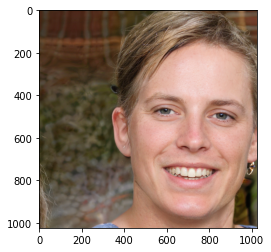

In [34]:
original = data['image'][0]
plt.imshow(original)

In [159]:
#For styleGAN3, we decided to only take the top3 channels to save time
def print_ranked_semantic_SG3R(layer,semantics = ['hair', 'mouth', 'eye'], number = 3):
  """
  layer: int, which layer we want the rank
  semantics: list of strings, for which semantics do we want the rank
  number: int, top number of channels
  """
  rankS3 = np.load('../logs/channelRankS3M/rankL{}.npy'.format(layer))
  print('Layer :{}'.format(layer))
  for semantic in semantics:
    rankedS3H = np.argsort(rankS3[0][:,merged_mask_idx[semantic]])[::-1]
    print(f'{semantic}  :{rankedS3H[:number]}')

In [165]:
# Helper fucntion to generate the images to plot
def generate_to_plot(layer, channels,alpha = 50, rotate=True): #We set the alpha to 50 cause we noticed that with 10 we didn't get any noticeable differences
  to_plot = []
  for channel in channels:
    if rotate:
        editedM   = np.array(edit_image_stylegan3(SG3, ysSG3R, -alpha, channel, layer))
        editedP   = np.array(edit_image_stylegan3(SG3, ysSG3R, alpha, channel, layer))
        to_plot.append([editedM, original, editedP])
    else:
        editedM   = np.array(edit_image_stylegan3(SG3, ysSG3T, -alpha, channel, layer))
        editedP   = np.array(edit_image_stylegan3(SG3, ysSG3T, alpha, channel, layer))
        to_plot.append([editedM, original, editedP])      
  
  return np.asarray(to_plot)

## Layer 4

In [52]:
layer = 4
print_ranked_semantic_SG3R(layer)

Layer :4
hair  :[253 586 613]
mouth  :[373  70 746]
eye  :[ 16  93 816]


### Hair

In [40]:
alpha = 50 
labels = ['hair', 'hair','hair']
channels = [253, 586, 613]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


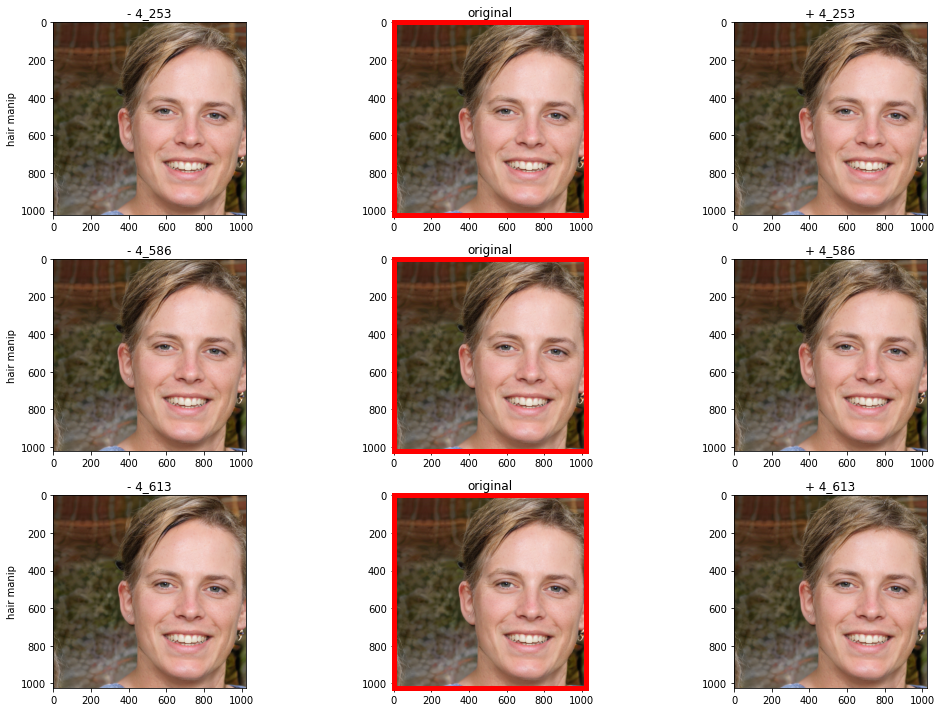

In [41]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [44]:
alpha = 50 
labels = ['mouth','mouth','mouth']
channels = [373,  70, 746]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


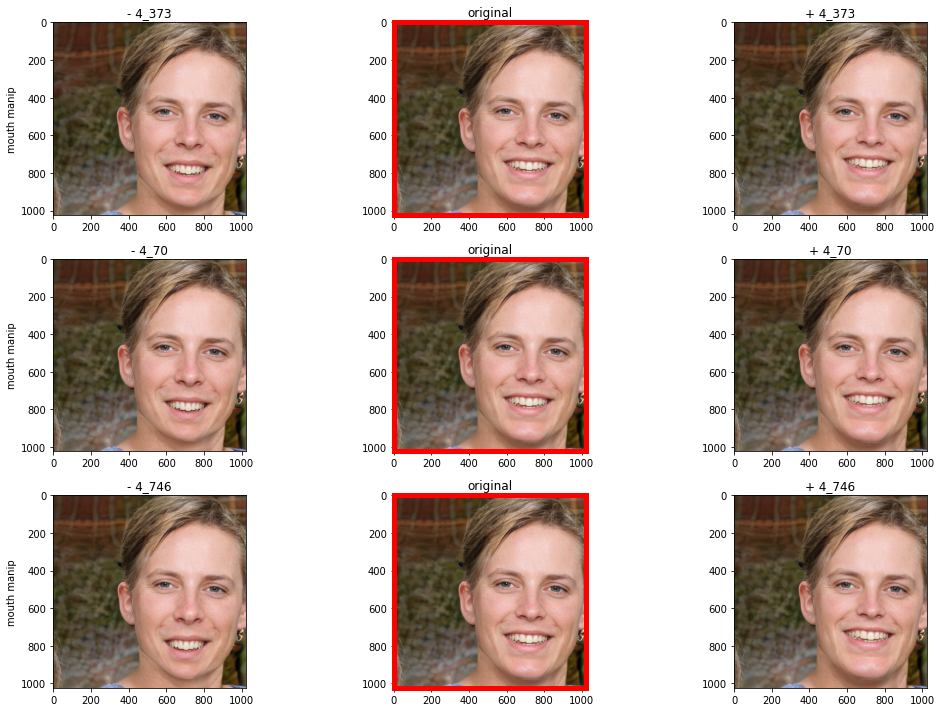

In [45]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [42]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels =  [16, 93, 816]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


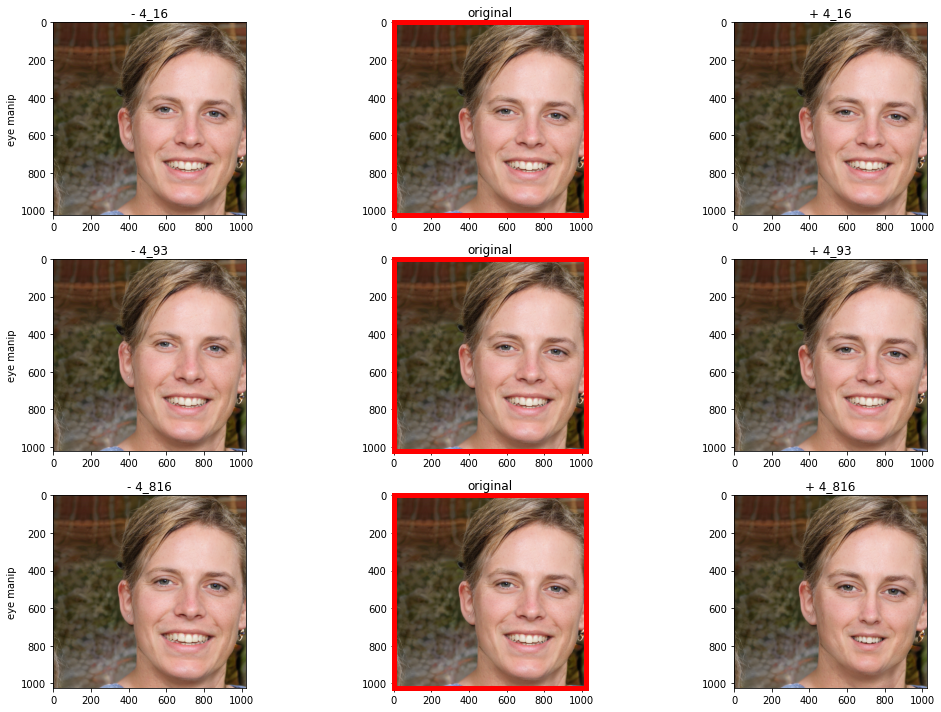

In [43]:
plotManip(to_plot, labels, layer, channels)

## Layer 5

In [53]:
layer = 5
print_ranked_semantic_SG3R(layer)

Layer :5
hair  :[618 127 983]
mouth  :[878 658 970]
eye  :[346 323 371]


### Hair

In [47]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [618, 127, 983]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


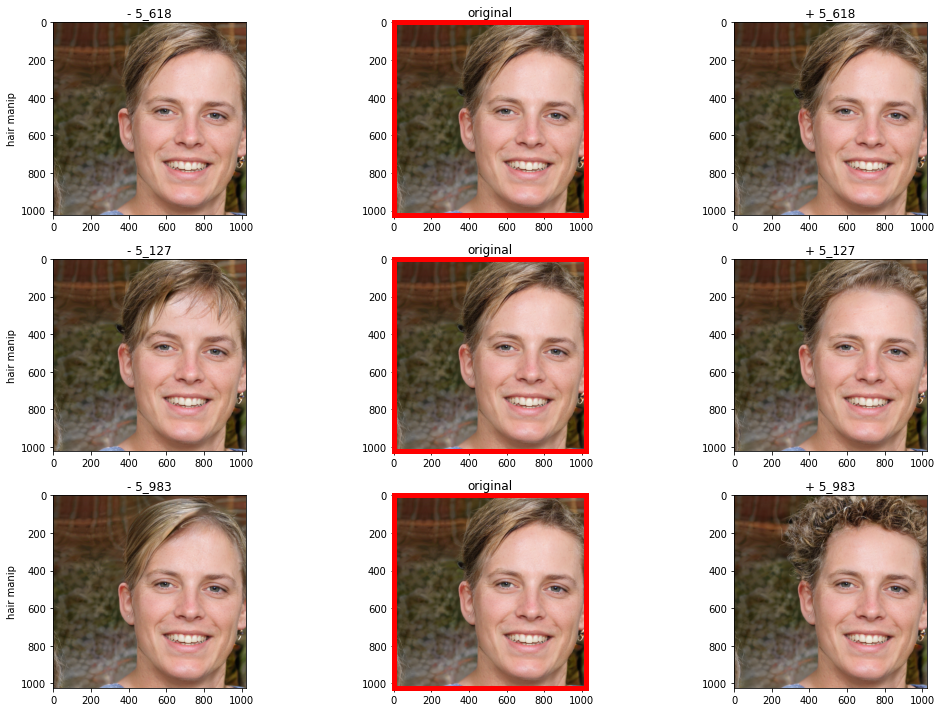

In [48]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [49]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [878, 658, 970]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


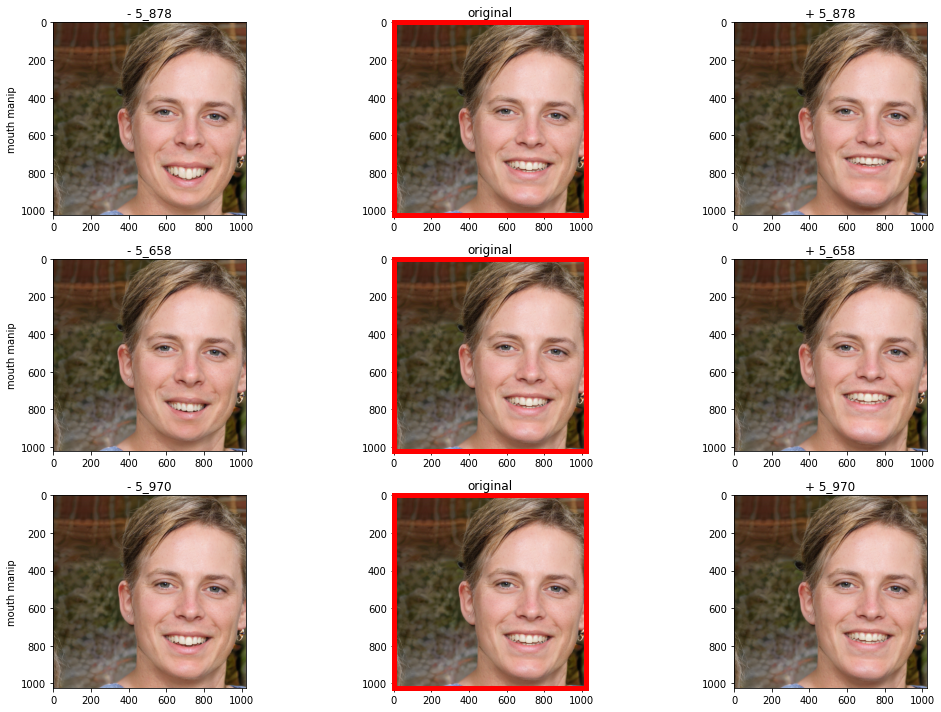

In [50]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [54]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [346, 323, 371]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


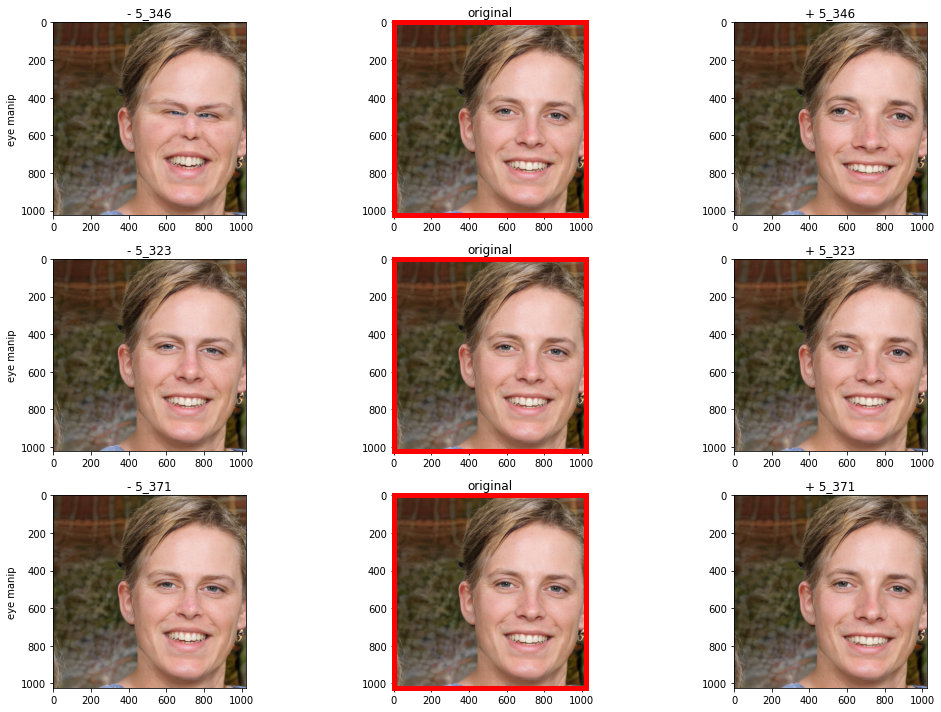

In [55]:
plotManip(to_plot, labels, layer, channels)

## Layer 7

In [56]:
layer = 7
print_ranked_semantic_SG3R(layer)

Layer :7
hair  :[940 528 693]
mouth  :[445 170 881]
eye  :[1009  363  425]


### Hair

In [57]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [940, 528, 693]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


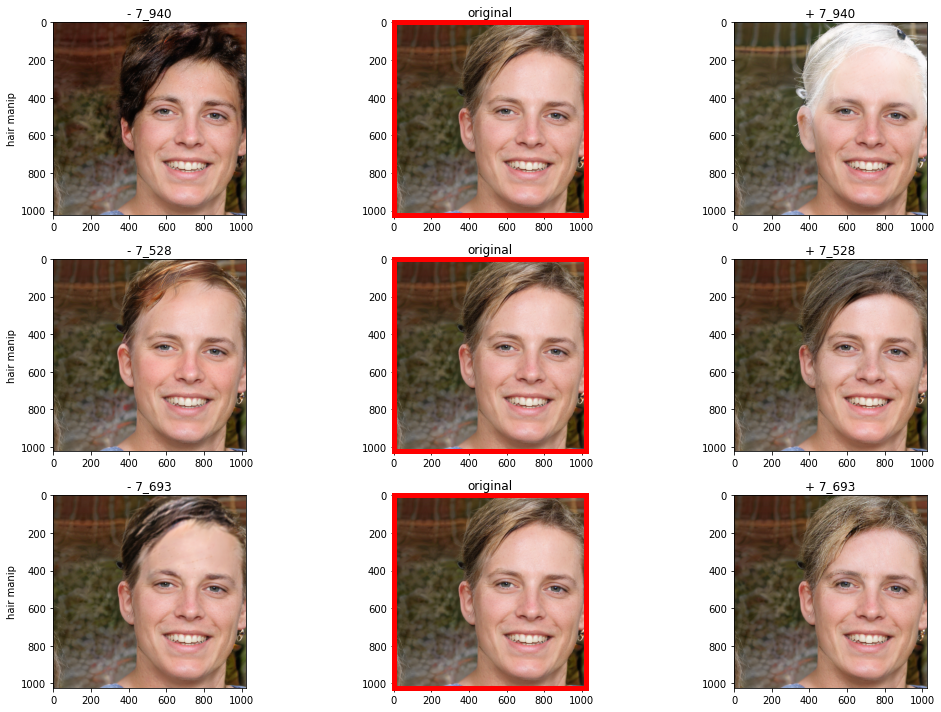

In [58]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [59]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [445, 170, 881]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


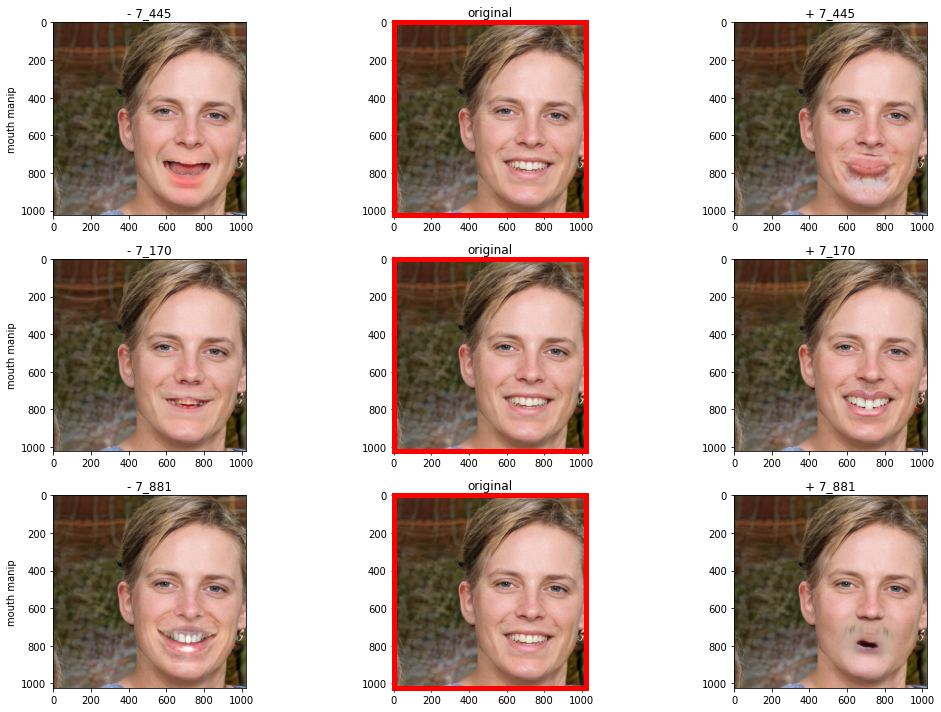

In [60]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [61]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [1009,  363,  425]
to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


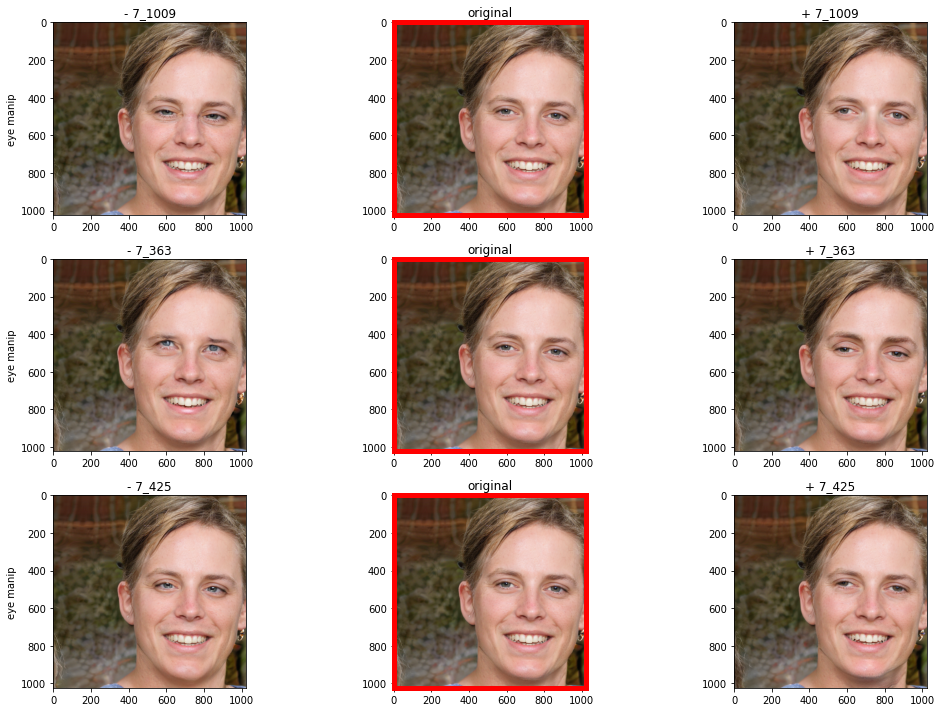

In [62]:
plotManip(to_plot, labels, layer, channels)

## Layer 8

In [63]:
layer = 8
print_ranked_semantic_SG3R(layer)

Layer :8
hair  :[ 91 102 907]
mouth  :[698 387 664]
eye  :[ 99 408 792]


### Hair

In [64]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [ 91, 102, 907]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


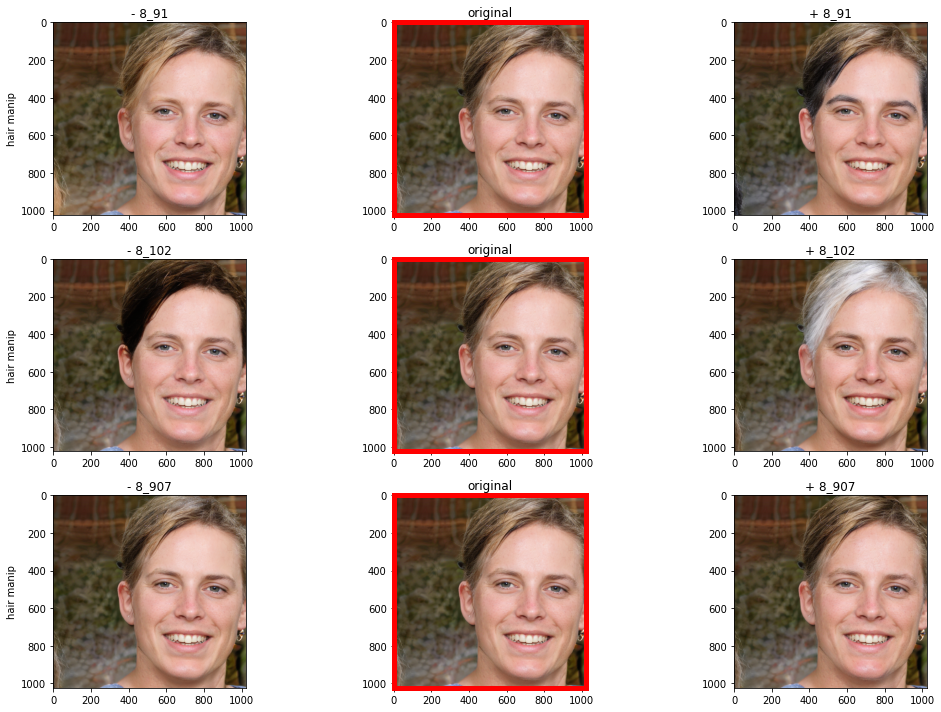

In [65]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [66]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [698, 387, 664]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


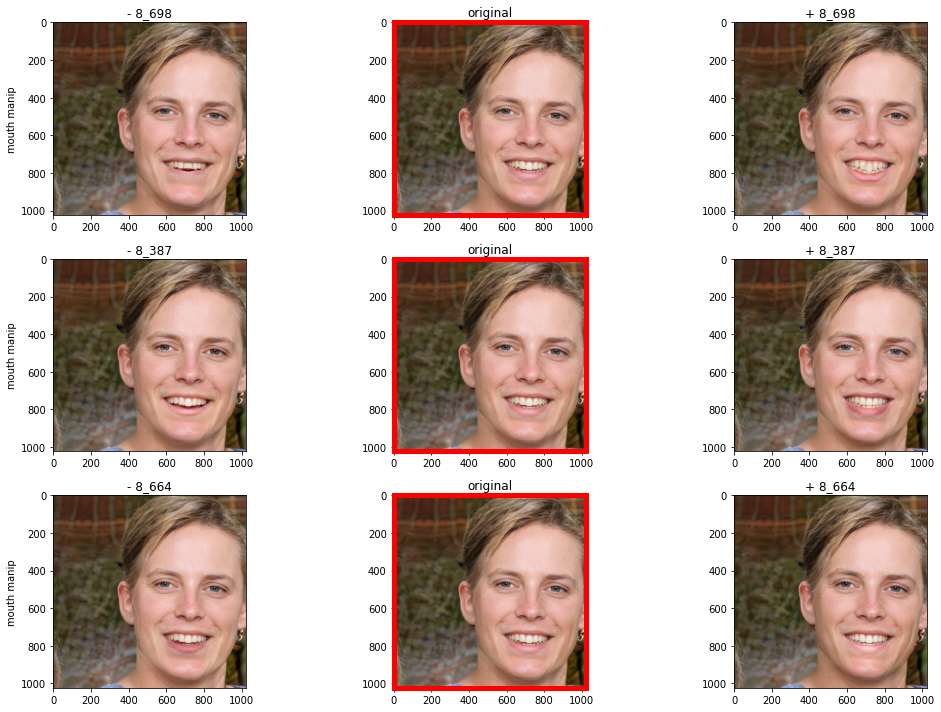

In [67]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [68]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [ 99, 408, 792]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


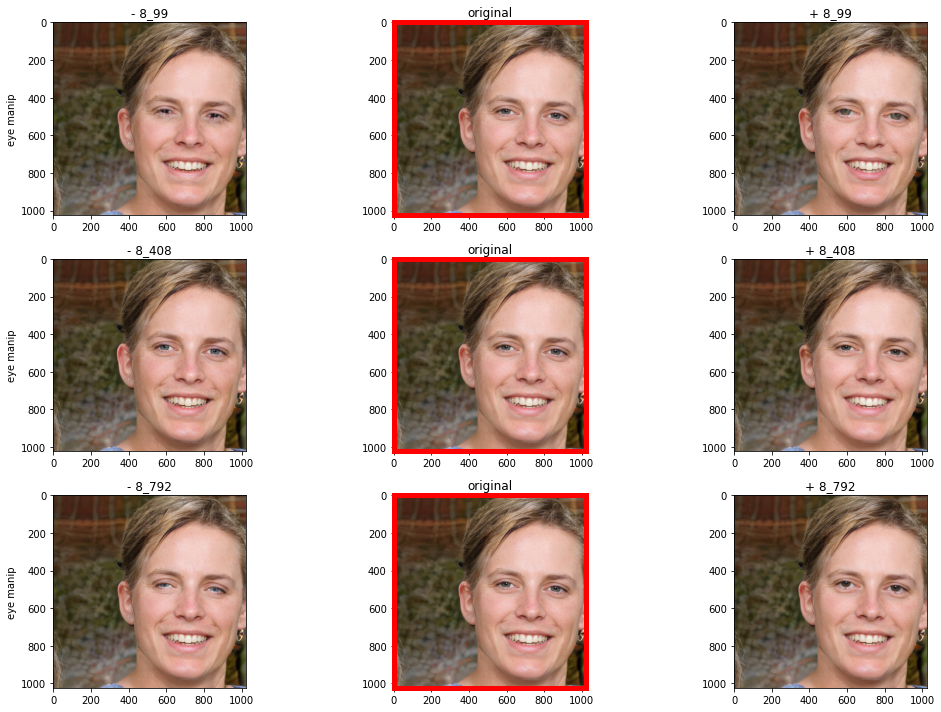

In [69]:
plotManip(to_plot, labels, layer, channels)

## Generating video for StyleGAN3

In [162]:
def generate_video_SG3(duration, fps, layer_to_modify, channel_to_modify, features_maps, alpha = 50):
  
  """
  duration: int, duration of the video in seconds
  fps: int, frames per second
  layer_to_modify: int, which layer do we want to apply the transformation
  channel_to_modify: int, which channel we want to apply the transformation within the specified layer
  features_maps: list of tuples of the form (layer, channel). Creates a video of the specified features map. In order to have RGB, we take the specified channel
  + the 2 channels AFTER the one specified.

  output: Video of the modification + if specified, video of the feature maps
  """
  
  alphas = np.linspace(-alpha, alpha, duration*fps)

  videos = {"video_SG3":[]} #Creation of the dictionnary containing the video

  #Creation of the entries for the feature maps
  for (layer, channel) in features_maps:
    videos[f"l_{layer}_c{channel}"] = []
  
  for alpha in alphas:
    data = edit_get_all_infos_stylegan3(SG3,ysSG3R,alpha,channel_to_modify,layer_to_modify)
    videos["video_SG3"].append(data['image'][0])
    for (layer, channel) in features_maps:
      videos[f"l_{layer}_c{channel}"].append(data[f'layer_{layer}'][0][channel:channel + 3])

  

  for key in videos:
    size = 0
    if key == 'video_SG3':
      size = videos[key][0].size
    else:
      size = videos[key][0].size()[1:3]
    
    out = cv2.VideoWriter(f'../video/output_{key}.avi',cv2.VideoWriter_fourcc(*"MJPG"), fps, (size[0], size[1]))
    for i in range(fps * duration):
      if key == 'video_SG3':
        img = np.array(videos[key][i], dtype='uint8')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      else:
        img = (videos[key][i].permute(1, 2, 0) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
        img = img.cpu().numpy()

    
      out.write(img)
    
    out.release()

In [147]:
generate_video_SG3(5,2, 5, 346, [(10,60)], alpha=100)

In [73]:
# Function to generate images to be in the report
def plotMultiple_same_edits(imageSeed):
        fig, ax = plt.subplots(1,5, figsize=(15,10))

        layers = [8, 5, 8, 8,]
        channels = [295, 983, 102,879]
        data   = get_batch_data(SG3, imageSeed, model_name, dataset_name, bs=1) 
        ys = data['ys']
        ax[0].imshow(data['image'][0])
        ax[0].axis('off')
        s = zip(channels, layers)
        alphas = [50,50,50,-50]
        for i , my_tuple in enumerate(s):
          alpha = alphas[i]
          new_img = edit_image_stylegan3(SG3,ys,alpha,my_tuple[0],my_tuple[1])
          ax[i+1].imshow(new_img)
          ax[i+1].axis('off')

        plt.tight_layout()
        plt.show()

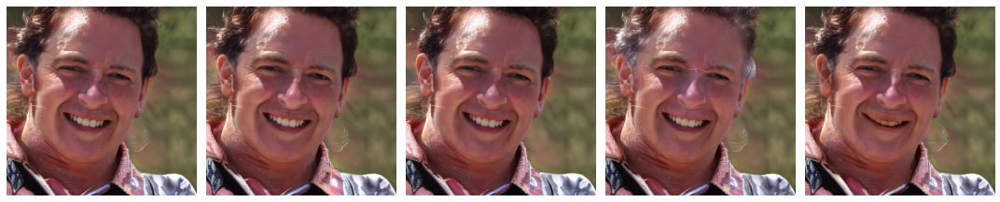

In [74]:
plotMultiple_same_edits(10206)

#StyleGAN3-T part

In [167]:
model_name = 'stylegan3'
dataset_name = "FFHQ-T" 
G      = load_pretrained_model(model_name, dataset_name)
device     = torch.device('cuda') 
SG3 = StyleGAN3SampleGenerator(G=G, device=device, truncation_psi=truncation_psi) 
          
# 1/ image generated with random seed outside of range we used for ranking 
# 2/ we use the same image for all layer manipulations like they do in the paper 
data   = get_batch_data(SG3, 10201, model_name, dataset_name, bs=1)
ysSG3T     = data['ys'] 

In [168]:
def print_ranked_semantic_SG3T(layer,semantics = ['hair', 'mouth', 'eye'], number = 3):
  """
  layer: int, which layer we want the rank
  semantics: list of strings, for which semantics do we want the rank
  number: int, top number of channels
  """
  rankS3 = np.load('../logs/channelRankS3TM/rankL{}.npy'.format(layer))
  print('Layer :{}'.format(layer))
  for semantic in semantics:
    rankedS3H = np.argsort(rankS3[0][:,merged_mask_idx[semantic]])[::-1]
    print(f'{semantic}  :{rankedS3H[:number]}')

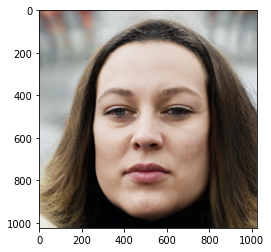

In [169]:
original = data['image'][0]
plt.imshow(original)

## Layer 4

In [170]:
layer = 4
print_ranked_semantic_SG3T(layer)

Layer :4
hair  :[196 324  95]
mouth  :[191  58  59]
eye  :[100 181  30]


### Hair

In [171]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [196, 324,  95]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  


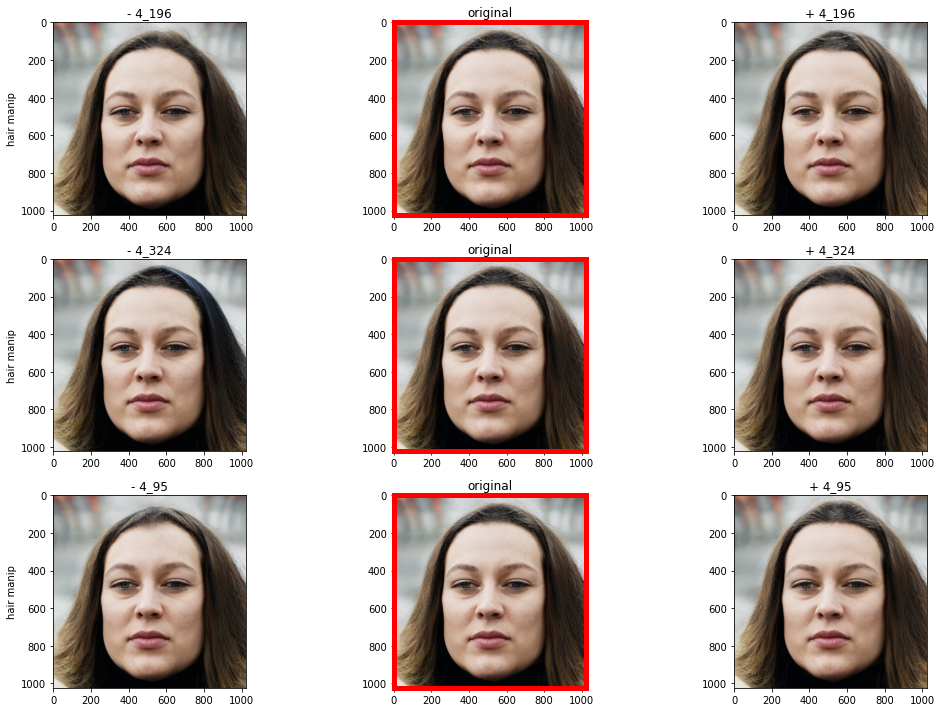

In [172]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [101]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [191,  58,  59]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


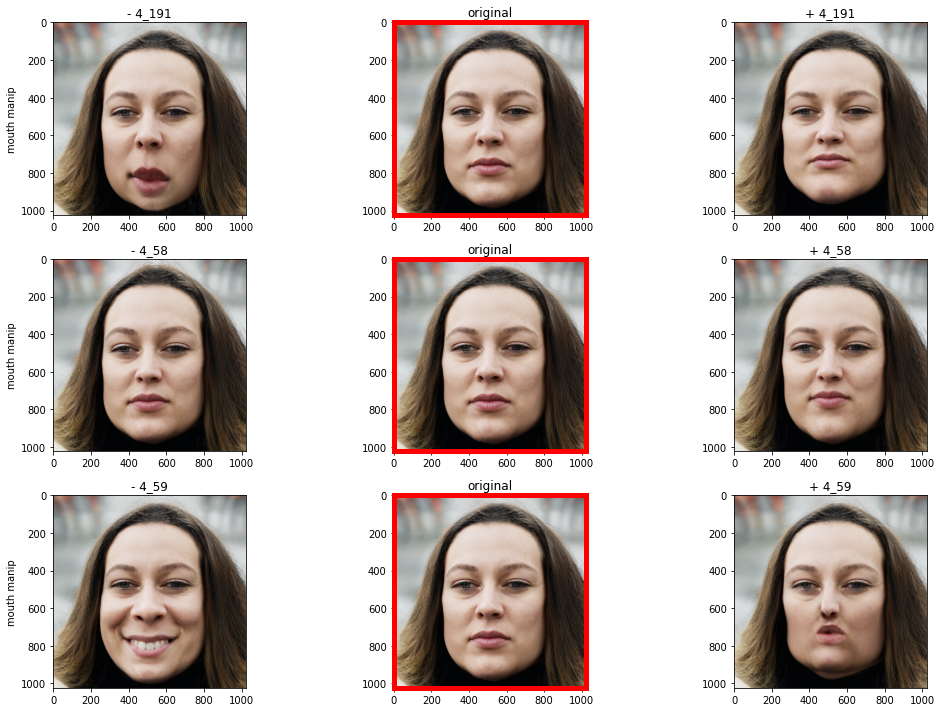

In [102]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [103]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [100, 181,  30]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


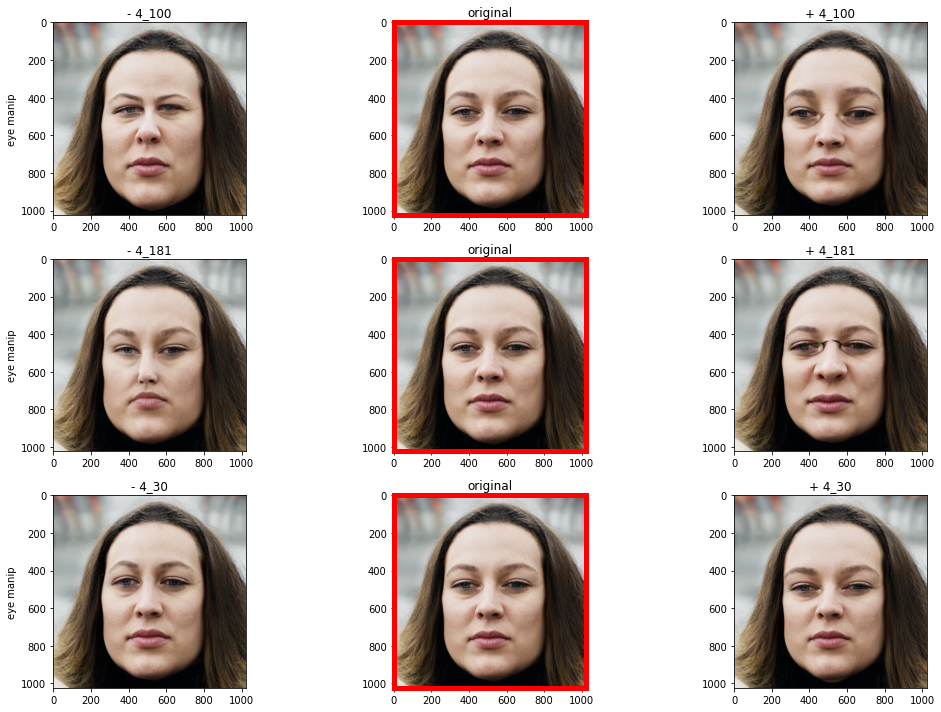

In [104]:
plotManip(to_plot, labels, layer, channels)

## Layer 5

In [105]:
layer = 5
print_ranked_semantic_SG3T(layer)

Layer :5
hair  :[164 471 380]
mouth  :[285 419 465]
eye  :[180 147 236]


### Hair

In [106]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [164, 471, 380]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


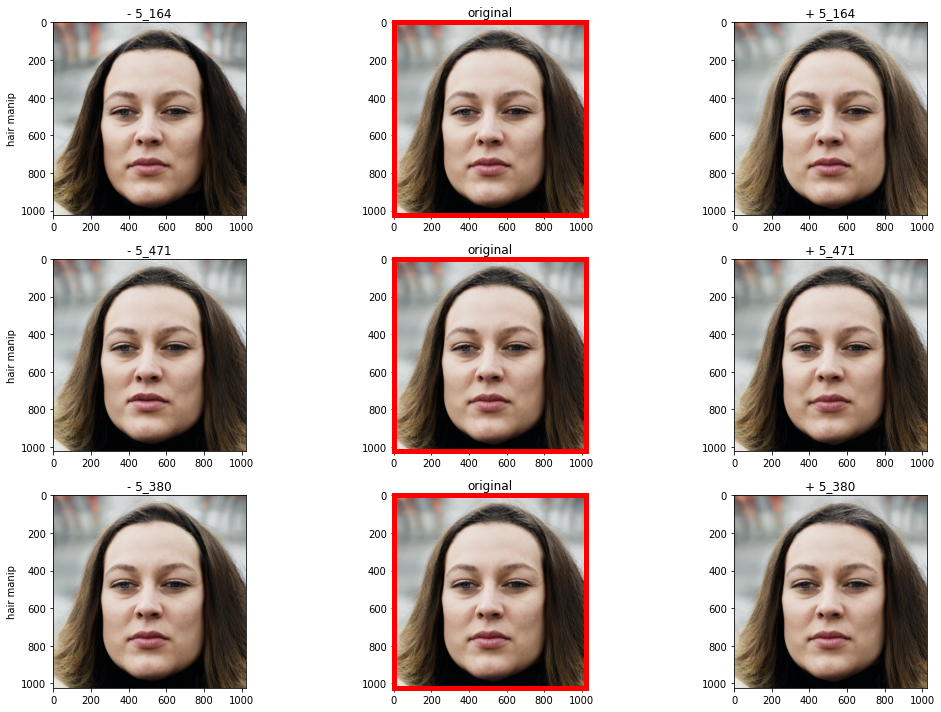

In [107]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [108]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [285, 419, 465]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


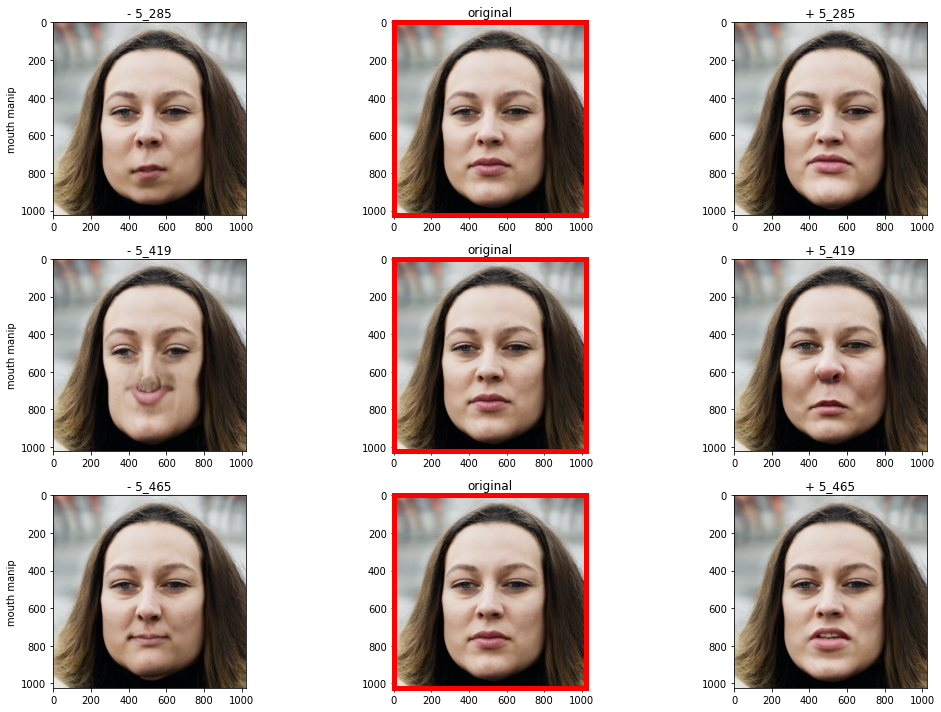

In [109]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [110]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [180, 147, 236]

to_plot = generate_to_plot(layer, channels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


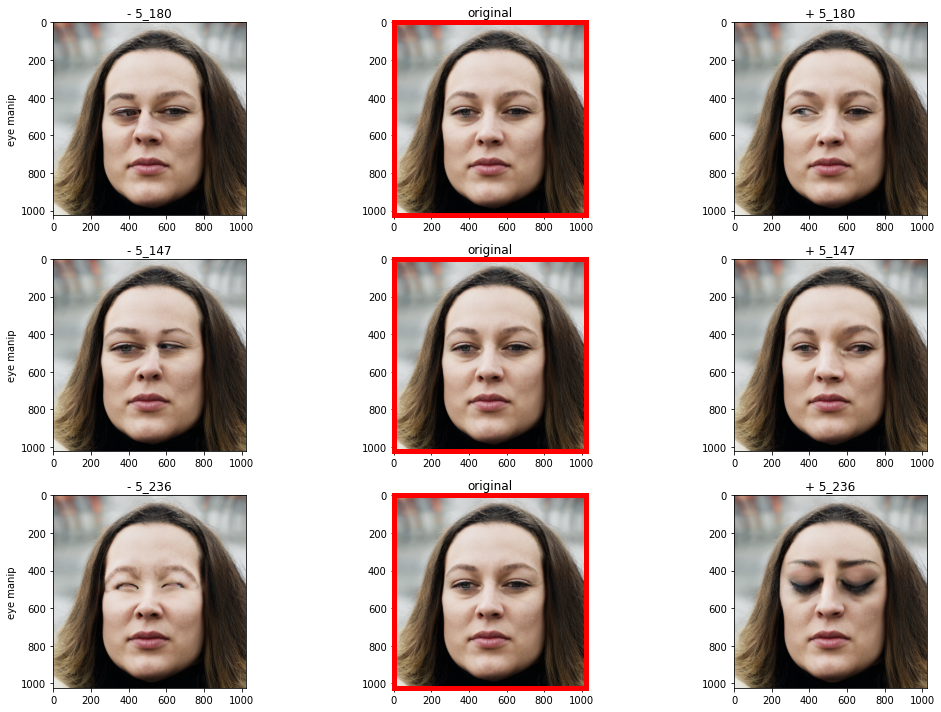

In [111]:
plotManip(to_plot, labels, layer, channels)

## Layer 6

In [112]:
layer = 6
print_ranked_semantic_SG3T(layer)

Layer :6
hair  :[259 226 212]
mouth  :[474 328 290]
eye  :[323 237  41]


### Hair

In [113]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [259, 226, 212]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


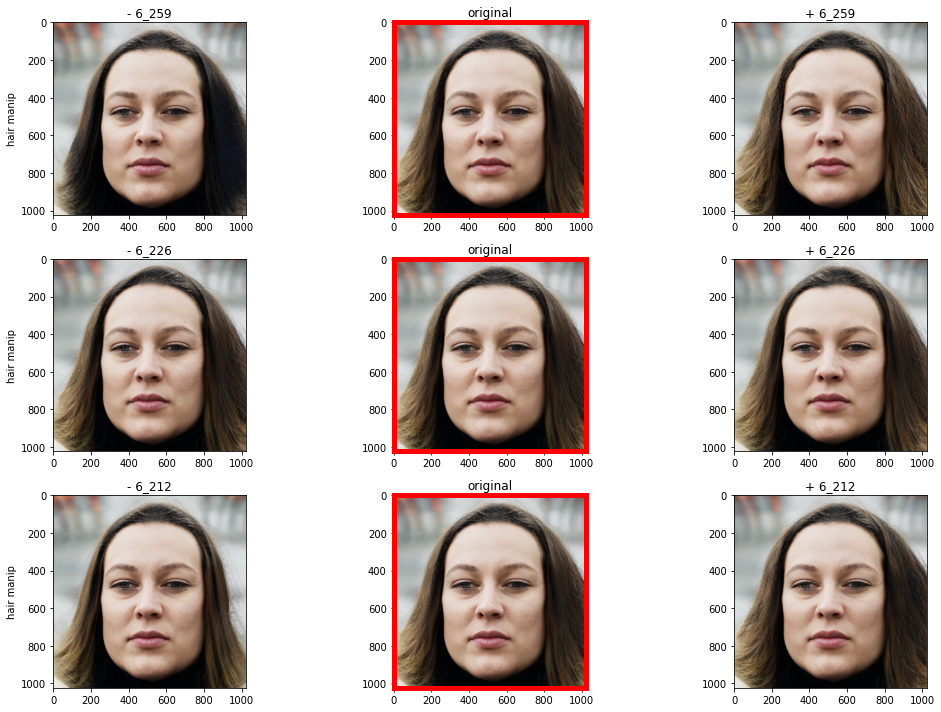

In [114]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [115]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [474, 328, 290]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


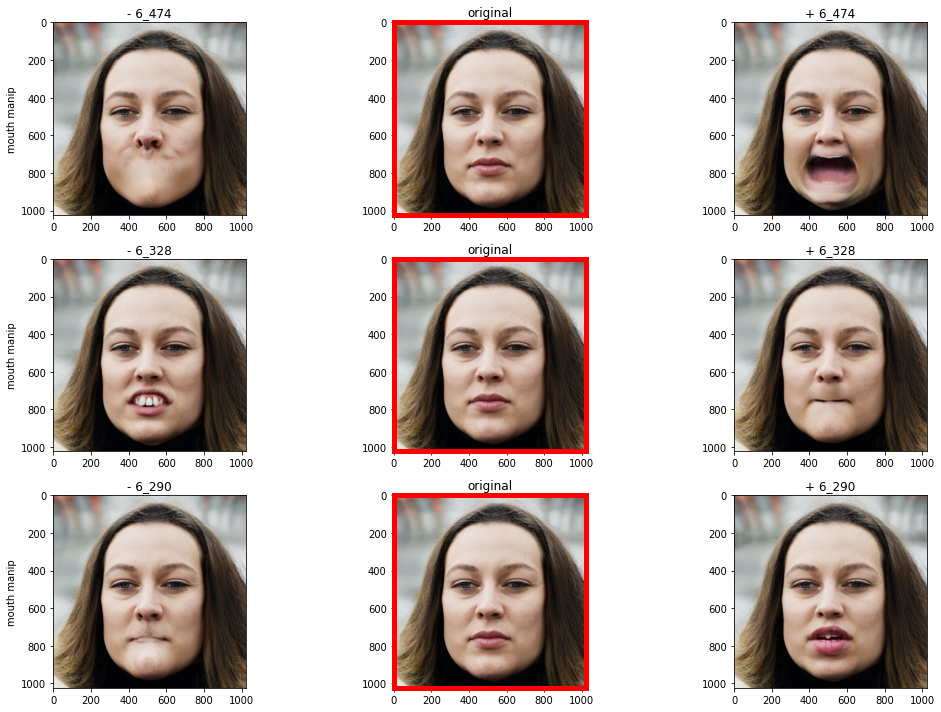

In [116]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [117]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [323, 237,  41]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


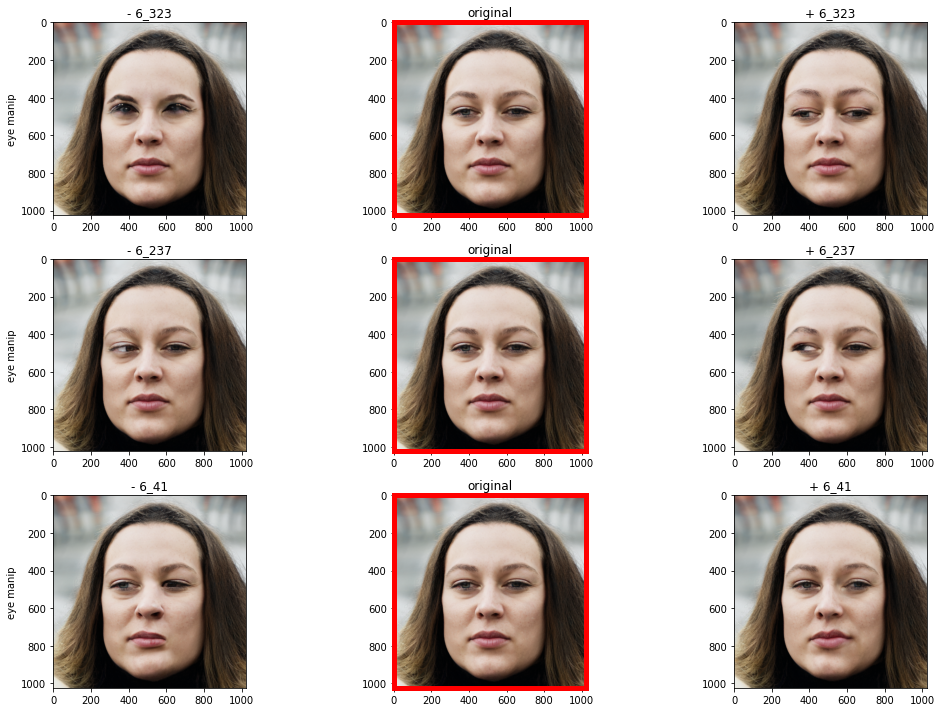

In [118]:
plotManip(to_plot, labels, layer, channels)

## Layer 7

In [119]:
layer = 7
print_ranked_semantic_SG3T(layer)

Layer :7
hair  :[ 65 225 134]
mouth  :[132 298  12]
eye  :[114 455  86]


### Hair

In [120]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [ 65, 225, 134]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


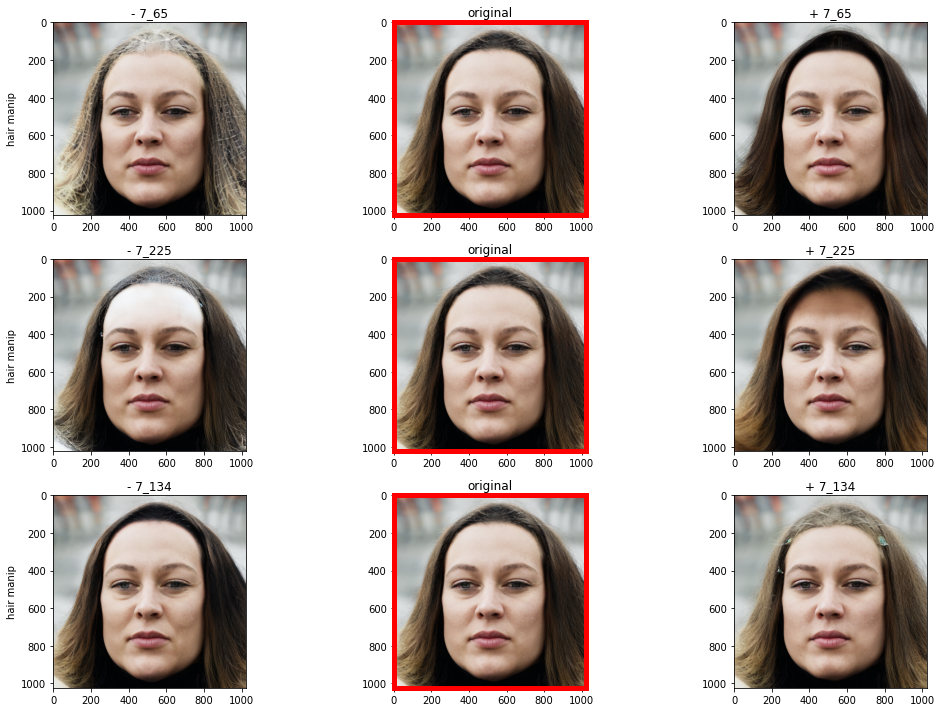

In [121]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [122]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [132, 298,  12]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


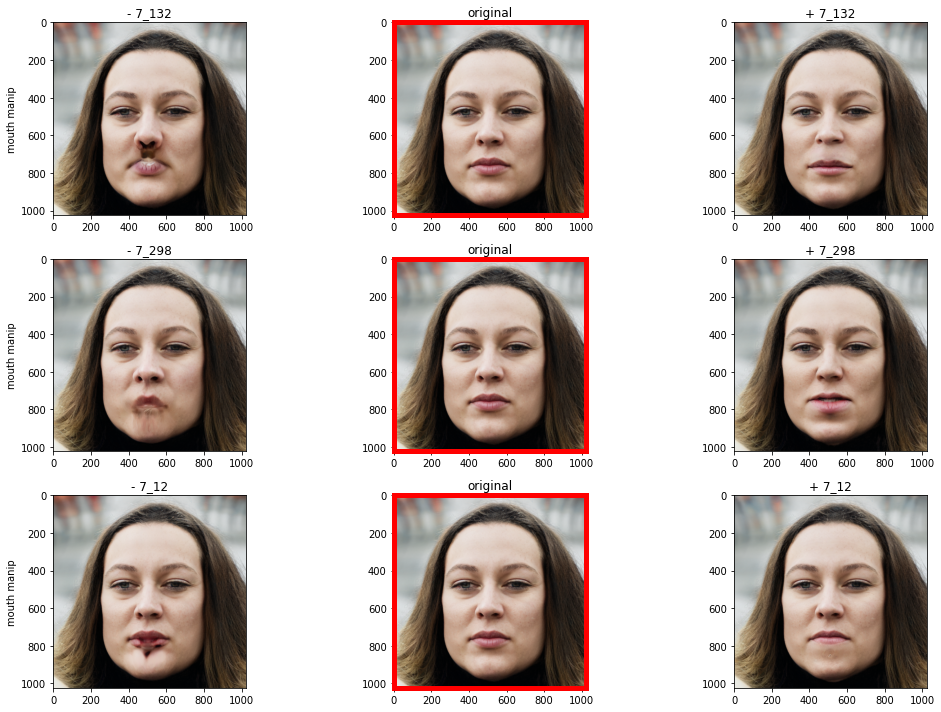

In [123]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [124]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [114, 455,  86]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


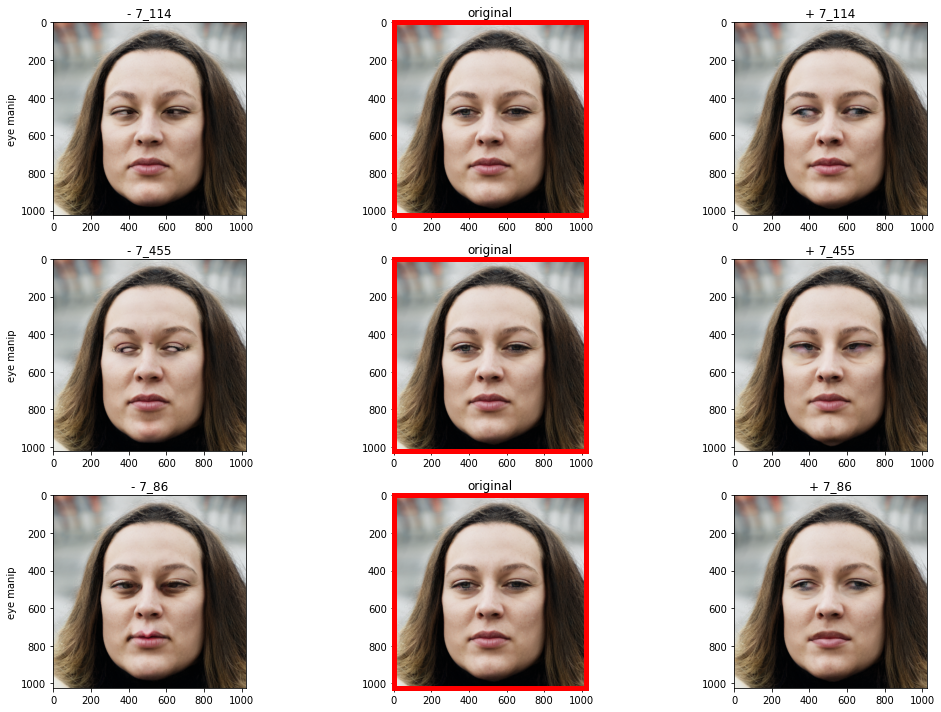

In [125]:
plotManip(to_plot, labels, layer, channels)

## Layer 8

In [126]:
layer = 8
print_ranked_semantic_SG3T(layer)

Layer :8
hair  :[159 316 109]
mouth  :[362 452 150]
eye  :[  4 252 335]


### Hair

In [127]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [159, 316, 109]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


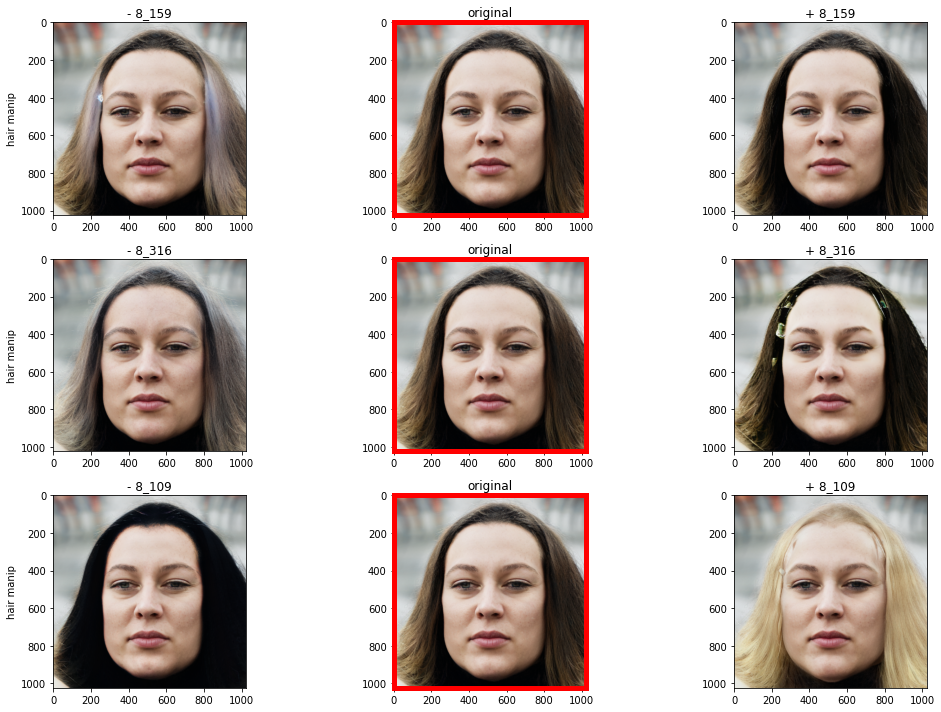

In [128]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [129]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [362, 452, 150]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


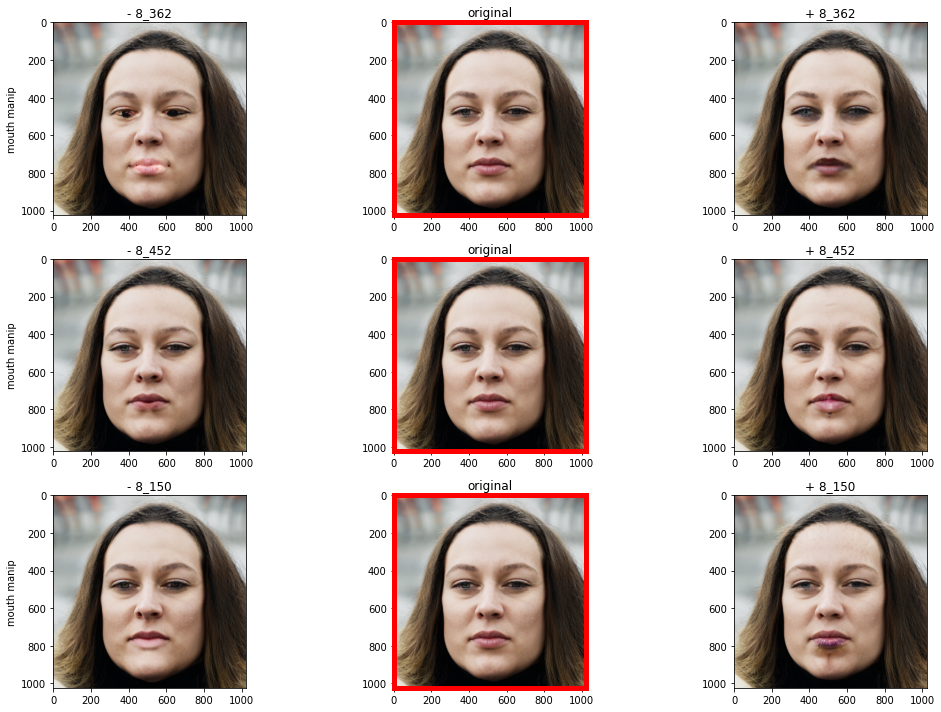

In [130]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [131]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [4, 252, 335]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


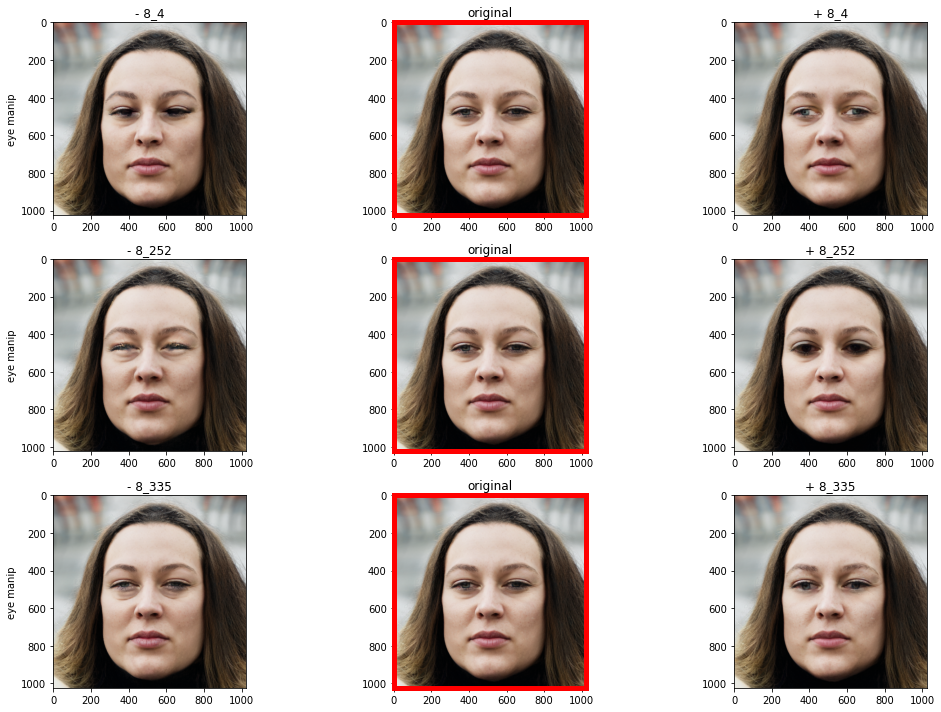

In [132]:
plotManip(to_plot, labels, layer, channels)

## Layer 9

In [133]:
layer = 9
print_ranked_semantic_SG3T(layer)

Layer :9
hair  :[217 117 267]
mouth  :[173  37 132]
eye  :[296  54 188]


### Hair

In [134]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [217, 117, 267]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


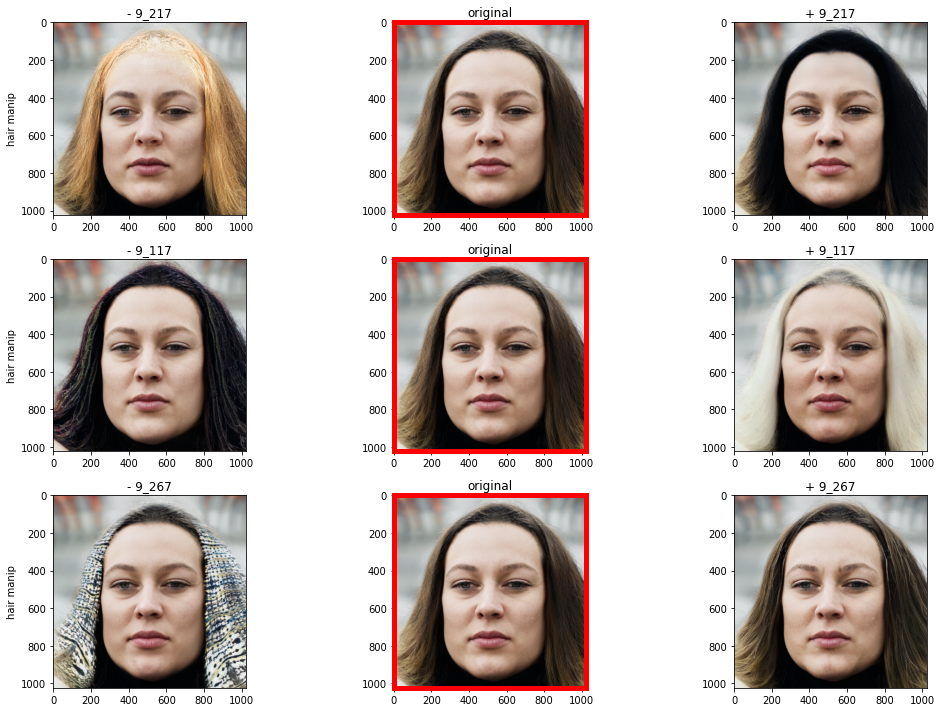

In [135]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [136]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [173,  37, 132]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


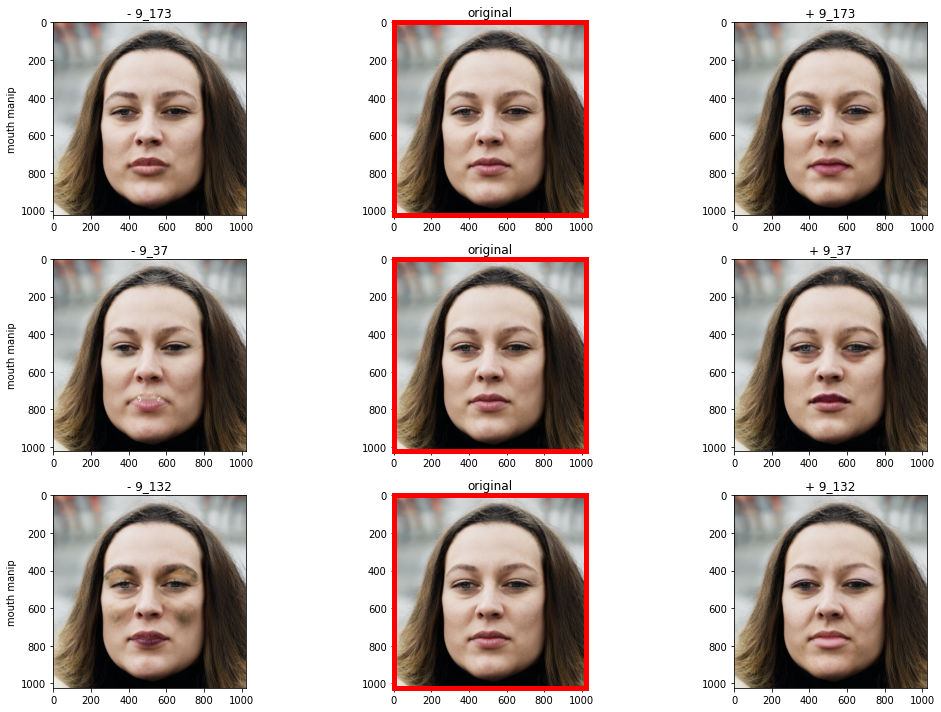

In [137]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [138]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [296,  54, 188]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


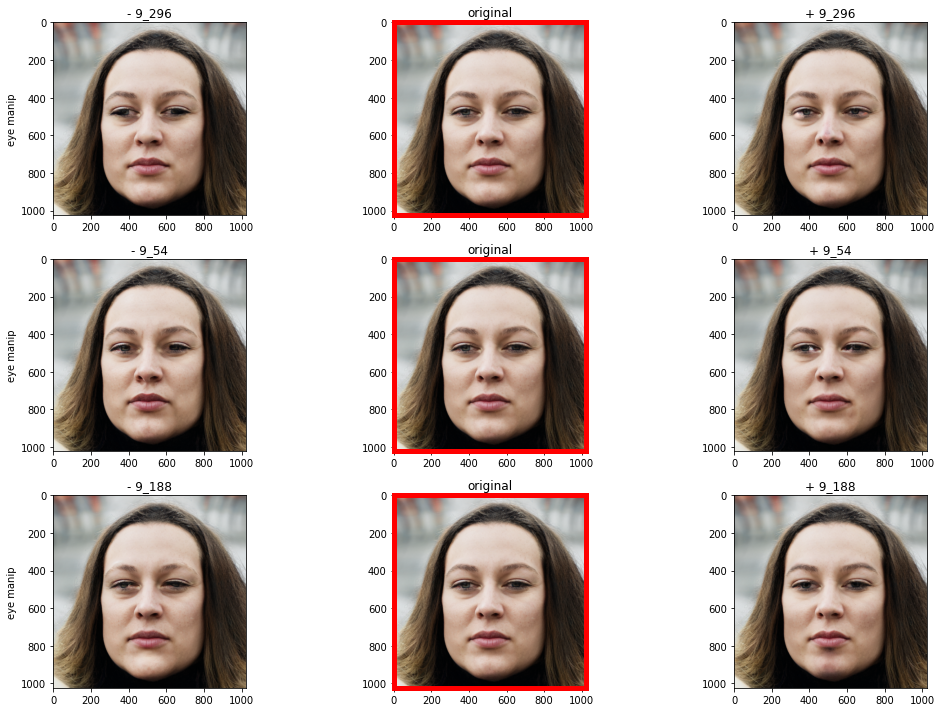

In [139]:
plotManip(to_plot, labels, layer, channels)

## Layer 10

In [140]:
layer = 10
print_ranked_semantic_SG3T(layer)

Layer :10
hair  :[ 36 128  23]
mouth  :[ 92   9 112]
eye  :[ 41   3 100]


### Hair

In [141]:
alpha = 50 
labels = ['hair', 'hair', 'hair']
channels = [36, 128,  23]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


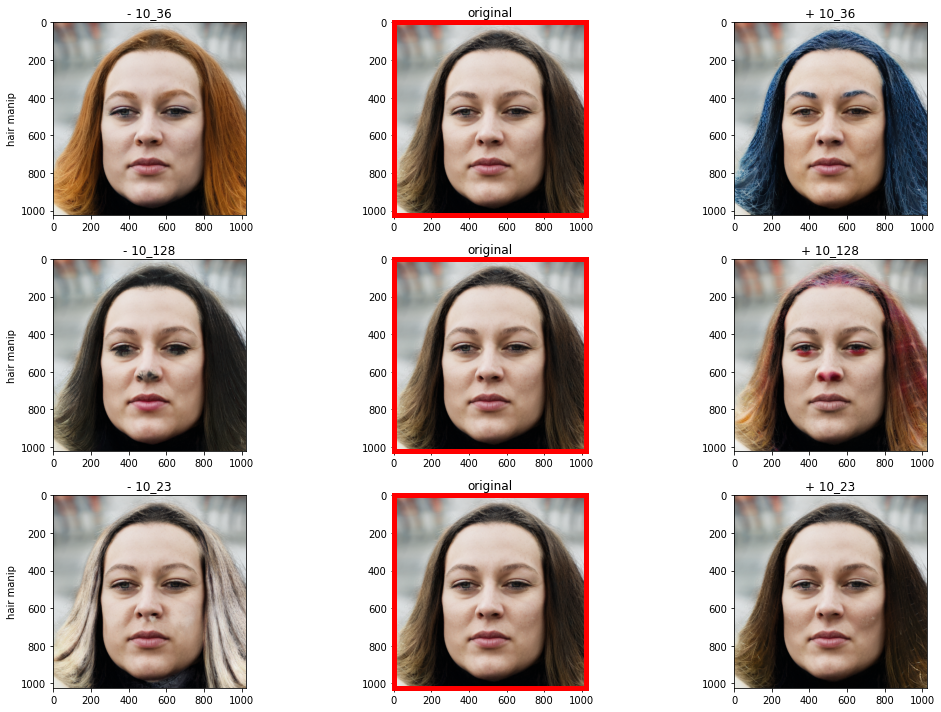

In [142]:
plotManip(to_plot, labels, layer, channels)

### Mouth

In [143]:
alpha = 50 
labels = ['mouth', 'mouth', 'mouth']
channels = [ 92,   9, 112]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


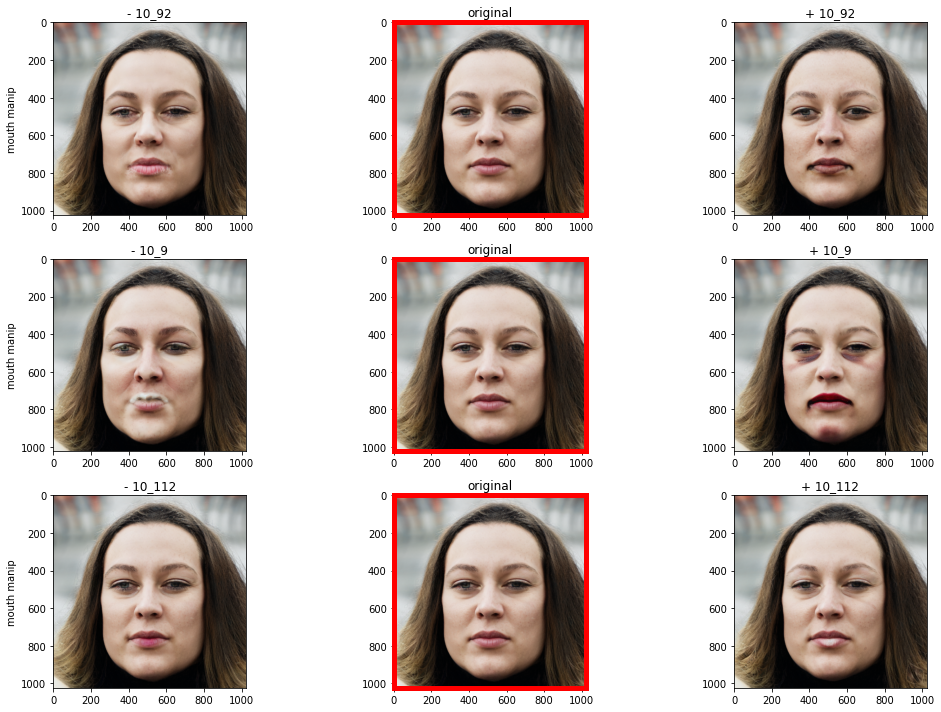

In [144]:
plotManip(to_plot, labels, layer, channels)

### Eyes

In [145]:
alpha = 50 
labels = ['eye', 'eye', 'eye']
channels = [ 41,   3, 100]

to_plot = generate_to_plot(layer, channels, rotate=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


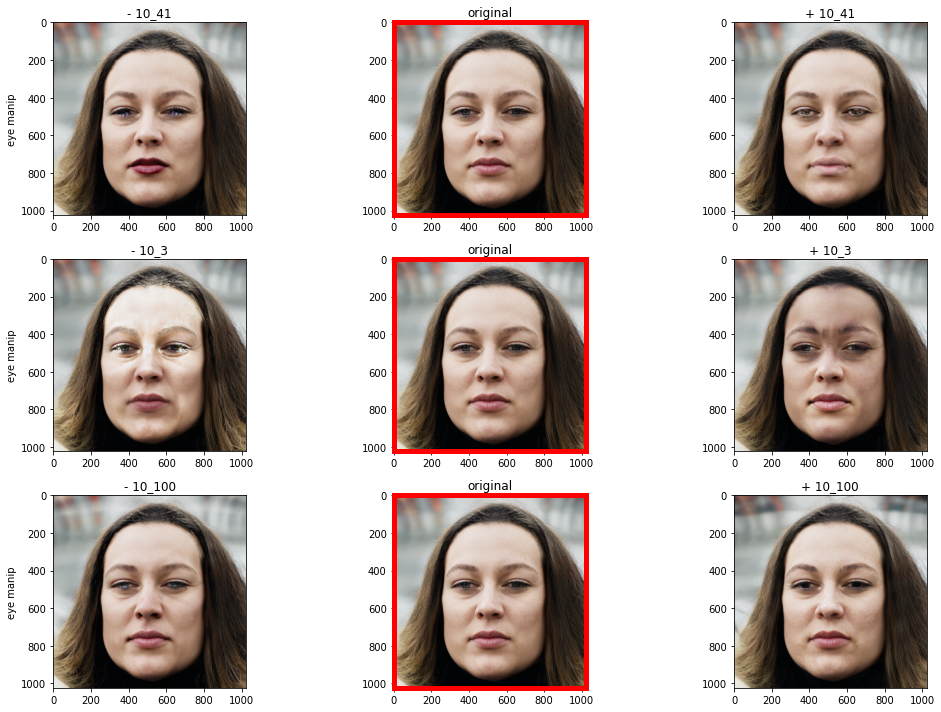

In [146]:
plotManip(to_plot, labels, layer, channels)

# Video of edits (edit change on output image and feature maps)

`generate_video_SG2` and `generate_video_SG3` defined in previous cells allowed user to generate a stream in `video` folder. 

Both edited images and edtied images'feature maps are showed in those folders.